In [42]:
#Loads some parameters
import CloudDataset128h
import torch
import matplotlib.pyplot as plt
import numpy as np
from torchvision import transforms
import torchvision.transforms.v2 as v2
from PIL import Image
import torch.nn as nn
from torchvision import models
from torch.nn.functional import relu
import torch.optim as optim
batch_size = 7

#imports state of the art model.
#model = torch.hub.load('pytorch/vision:v0.10.0', 'fcn_resnet50')
print("Load successfull")


Load successfull


<class 'torch.Tensor'>
torch.Size([7, 12, 128, 128])
torch.Size([7, 6, 128, 128])


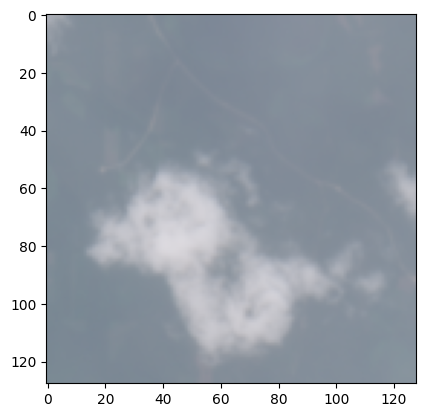

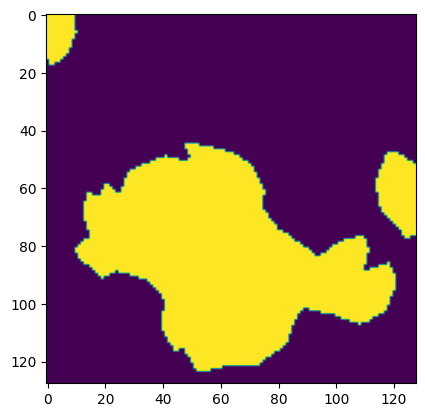

In [43]:
transform = {
    "image": v2.Compose([
    transforms.Resize(size=(256,256)),
]),
    "mask": v2.Compose([
    transforms.Resize(size=(256,256)),
])}

# Get the dataset of the CloudDataset
dataset = CloudDataset128h.CloudDataset("data\\train",transform=transform)

# Creates validation/training dataset with 20/80 split
validation_dataset, training_dataset = torch.utils.data.random_split(dataset,[0.2, 0.8])

# Create a DataLoaders from the datasets.
validation_loader = torch.utils.data.DataLoader(validation_dataset, batch_size=batch_size, shuffle=True)
training_loader = torch.utils.data.DataLoader(training_dataset, batch_size=batch_size, shuffle=True)

# Creates an iterator and plots the pictures
it = iter(training_loader)
images, labels = next(it)

print(type(images))
print(images.shape)
print(labels.shape)

plt.figure()
plt.imshow(images[0][:3].permute(1,2,0))
plt.show()

plt.figure()
i=4
plt.imshow(labels[0][i:i+1].permute(1,2,0))
plt.show()

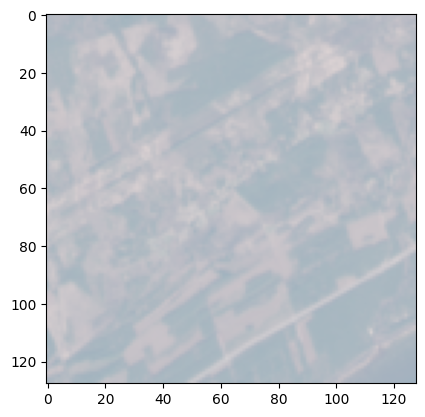

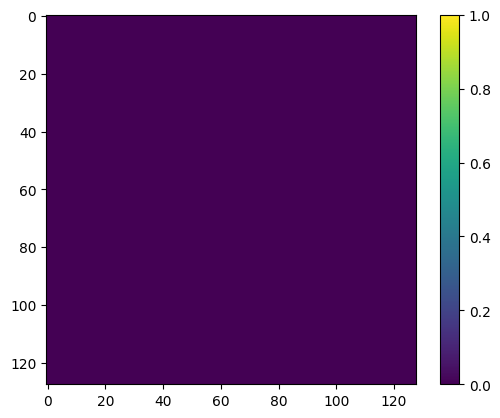

In [44]:
# Grabs next bath of pictures and displays the first, run multiple times for different plots
images, labels = next(it)

plt.figure()
plt.imshow(images[0][:3].permute(1,2,0))
plt.show()

plt.figure()
i=4
img = plt.imshow(labels[0][i:i+1].permute(1,2,0),vmin=0,vmax=1)
plt.colorbar(img)
plt.show()

In [45]:
class UNet(nn.Module):
    def __init__(self, n_class):
        super().__init__()
        
        # Encoder
        # In the encoder, convolutional layers with the Conv2d function are used to extract features from the input image. 
        # Each block in the encoder consists of two convolutional layers followed by a max-pooling layer, with the exception of the last block which does not include a max-pooling layer.
        # -------
        # input: 128x128x12
        self.e11 = nn.Conv2d(12, 64, kernel_size=3, padding=1) # output: 128x128x64
        self.e12 = nn.Conv2d(64, 64, kernel_size=3, padding=1) # output: 128x128x64
        self.pool1 = nn.MaxPool2d(kernel_size=2, stride=2) # output: 64x64x64

        # input: 64x64x64
        self.e21 = nn.Conv2d(64, 128, kernel_size=3, padding=1) # output: 64x64x128
        self.e22 = nn.Conv2d(128, 128, kernel_size=3, padding=1) # output: 64x64x128
        self.pool2 = nn.MaxPool2d(kernel_size=2, stride=2) # output: 32x32x128

        # input: 32x32x128
        self.e31 = nn.Conv2d(128, 256, kernel_size=3, padding=1) # output: 32x32x256
        self.e32 = nn.Conv2d(256, 256, kernel_size=3, padding=1) # output: 32x32x256
        self.pool3 = nn.MaxPool2d(kernel_size=2, stride=2) # output: 16x16x256

        # input: 16x16x256
        self.e41 = nn.Conv2d(256, 512, kernel_size=3, padding=1) # output: 16x16x512
        self.e42 = nn.Conv2d(512, 512, kernel_size=3, padding=1) # output: 16x16x512
        self.pool4 = nn.MaxPool2d(kernel_size=2, stride=2) # output: 8x8x512

        # input: 8x8x512
        self.e51 = nn.Conv2d(512, 1024, kernel_size=3, padding=1) # output: 8x8x1024
        self.e52 = nn.Conv2d(1024, 1024, kernel_size=3, padding=1) # output: 8x8x1024
        self.pool5 = nn.MaxPool2d(kernel_size=2, stride=2) # output: 4x4x1024

        # input: 4x4x1024
        self.e61 = nn.Conv2d(1024, 2048, kernel_size=3, padding=1) # output: 4x4x2048
        self.e62 = nn.Conv2d(2048, 2048, kernel_size=3, padding=1) # output: 4x4x2048


        # Decoder
        # input: 4x4x2048
        self.upconv0 = nn.ConvTranspose2d(2048, 1024, kernel_size=2, stride=2) # output: 8x8x2048
        self.d01 = nn.Conv2d(2048, 1024, kernel_size=3, padding=1) # output: 8x8x1024
        self.d02 = nn.Conv2d(1024, 1024, kernel_size=3, padding=1) # output: 8x8x1024


        # input: 8x8x1024
        self.upconv1 = nn.ConvTranspose2d(1024, 512, kernel_size=2, stride=2) # output: 16x16x1024
        self.d11 = nn.Conv2d(1024, 512, kernel_size=3, padding=1) # output: 16x16x512
        self.d12 = nn.Conv2d(512, 512, kernel_size=3, padding=1) # output: 16x16x512

        # input: 16x16x512
        self.upconv2 = nn.ConvTranspose2d(512, 256, kernel_size=2, stride=2) # output: 32x32x512
        self.d21 = nn.Conv2d(512, 256, kernel_size=3, padding=1) # output: 32x32x256
        self.d22 = nn.Conv2d(256, 256, kernel_size=3, padding=1) # output: 32x32x256

        # input: 32x32x256
        self.upconv3 = nn.ConvTranspose2d(256, 128, kernel_size=2, stride=2) # output: 64x64x256
        self.d31 = nn.Conv2d(256, 128, kernel_size=3, padding=1) # output: 64x64x128
        self.d32 = nn.Conv2d(128, 128, kernel_size=3, padding=1) # output: 64x64x128

        # input: 64x64x128
        self.upconv4 = nn.ConvTranspose2d(128, 64, kernel_size=2, stride=2) # output: 128x128x128
        self.d41 = nn.Conv2d(128, 64, kernel_size=3, padding=1) # output: 128x128x64
        self.d42 = nn.Conv2d(64, 64, kernel_size=3, padding=1) # output: 128x128x64

        # Output layer
        # input: 128x128x64
        self.outconv = nn.Conv2d(64, n_class, kernel_size=1) # output: 128 x 128 x n_class

        #Dropout
        self.dropout = nn.Dropout(0.85)
    
    def forward(self, x):
        # Encoder
        #print(x.shape)
        xe11 = relu(self.e11(x))
        #print(xe11.shape)
        xe12 = relu(self.e12(xe11))
        #print(xe12.shape)
        xp1 = self.pool1(xe12)
        #print(xp1.shape)

        xe21 = relu(self.e21(xp1))
        #print(xe21.shape)
        xe22 = relu(self.e22(xe21))
        #print(xe22.shape)
        xp2 = self.pool2(xe22)
        #print(xp2.shape)

        xe31 = relu(self.e31(xp2))
        #print(xe31.shape)
        xe32 = relu(self.e32(xe31))
        #print(xe32.shape)
        xp3 = self.pool3(xe32)
        #print(xp3.shape)

        xe41 = relu(self.e41(xp3))
        #print(xe41.shape)
        xe42 = relu(self.e42(xe41))
        #print(xe42.shape)
        xp4 = self.pool4(xe42)
        #print(xp4.shape)

        xe51 = relu(self.e51(xp4))
        #print(xe51.shape)
        xe52 = relu(self.e52(xe51))
        #print(xe52.shape)
        xp5 = self.pool5(xe52)
        #print(xp5.shape)

        xe61 = relu(self.e61(xp5))
        #print(xe51.shape)
        xe62 = relu(self.e62(xe61))
        #print(xe52.shape)
        
        # Decoder
        xu0 = self.upconv0(xe62)
        xu01 = torch.cat([xu0, xe52], dim=1)
        xd01 = relu(self.d01(xu01))
        xd02 = relu(self.d02(xd01))

        xu1 = self.upconv1(xd02)
        xu11 = torch.cat([xu1, xe42], dim=1)
        xd11 = relu(self.d11(xu11))
        xd12 = relu(self.d12(xd11))

        xu2 = self.upconv2(xd12)
        xu22 = torch.cat([xu2, xe32], dim=1)
        xd21 = relu(self.d21(xu22))
        xd22 = relu(self.d22(xd21))

        xu3 = self.upconv3(xd22)
        xu33 = torch.cat([xu3, xe22], dim=1)
        xd31 = relu(self.d31(xu33))
        xd32 = relu(self.d32(xd31))

        xu4 = self.upconv4(xd32)
        xu44 = torch.cat([xu4, xe12], dim=1)
        xd41 = relu(self.d41(xu44))
        xd42 = relu(self.d42(xd41))

        # Output layer
        out=self.outconv(xd42)

        return out

In [47]:
import copy
from time import perf_counter

epochs=500
best_loss_g=2
def train_model(train_loader, val_loader, model, criterion, optimizer, scheduler):
    start_time = perf_counter()
    time = 0
    epoch_since=0


    best_loss = 2
    er=5

    train_loss = []
    val_loss = []
    for epoch in range(epochs):
        avg_loss_list = []
        for batch_nr, (images,labels) in enumerate(train_loader):
            #Forward pass
            predictions = model(images.float())
            loss = criterion(predictions,labels.float())
            avg_loss_list.append(loss.item())
            
            if((batch_nr+epoch)%5==0):
                print("Epoch:",epoch,"Epoch since:",epoch_since,"er:",er,"batch_nr:",batch_nr,"Time:",perf_counter()-start_time,"Time_diff:",perf_counter()-start_time-time,"loss:",(sum(avg_loss_list)/len(avg_loss_list)))
            time=perf_counter()-start_time

            #Backward pass
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            # Update learning rate
            scheduler.step()
        

        avg_v_loss_list = []
        for batch_nr, (images_valid,labels_valid) in enumerate(val_loader):
            predictions = model(images_valid.float())
            loss = criterion(predictions,labels_valid.float())
            avg_v_loss_list.append(loss.item())

        train_loss.append((sum(avg_loss_list)/len(avg_loss_list)))
        val_loss.append((sum(avg_v_loss_list)/len(avg_v_loss_list)))

        #Finds best model
        if (val_loss[-1]<best_loss):
            best_loss=val_loss[-1]
            best_model = copy.deepcopy(model)
            torch.save(model, 'best_UNET128g_model.pt')
            print("\n New best loss:",best_loss)
            epoch_since=0
            er=5

            
            plt.figure()
            plt.imshow(images_valid[0][:3].permute(1,2,0))
            plt.show()
            
            i=4

            predictions_softmax = nn.Softmax(dim=1)(predictions.detach())

            plt.figure()
            img=plt.imshow(predictions_softmax[0][i:i+1][:3].permute(1,2,0),vmin=0, vmax=1)
            plt.colorbar(img)
            plt.show()

            a = predictions_softmax.argmax (1)
            predictions_binary = torch.zeros(predictions_softmax.shape).scatter (1, a.unsqueeze (1), 1.0)

            plt.figure()
            img=plt.imshow(predictions_binary[0][i:i+1].permute(1,2,0),vmin=0, vmax=1)
            plt.colorbar(img)
            plt.show()


            plt.figure()
            img=plt.imshow(labels_valid[0][i:i+1].permute(1,2,0),vmin=0, vmax=1)
            plt.colorbar(img)
            plt.show()
        else:
            print("new val loss:",val_loss[-1])
            epoch_since += 1
            if epoch_since>er:
                er+=1
                print("initzilating reload")
                model=torch.load('best_UNET128g_model.pt')
                epoch_since=0
    
    plt.plot(range(1,epochs+1),train_loss, color='r', label='losses')
    plt.plot(range(1,epochs+1),val_loss, color='g', label='losses_valid')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.show()

    return best_model

    

model = torch.load('best_UNET128h_model.pt')
optimizer = optim.Adam(model.parameters(),lr=1e-3)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=8, gamma=0.9)
criterion = nn.CrossEntropyLoss(weight=torch.Tensor([627.9819277108434, 1.0, 2.606294409136594, 1.537174118202194, 1.5951261013401232, 7.415034213933109]))

best_model=train_model(training_loader,validation_loader,model,criterion,optimizer,scheduler)


Epoch: 0 Epoch since: 0 er: 5 batch_nr: 0 Time: 4.988210500043351 Time_diff: 4.988213100004941 loss: 1.3799688816070557
Epoch: 0 Epoch since: 0 er: 5 batch_nr: 5 Time: 50.753086400043685 Time_diff: 8.245548699982464 loss: 2.415012697378794
Epoch: 0 Epoch since: 0 er: 5 batch_nr: 10 Time: 88.7134738000459 Time_diff: 5.0175060000037774 loss: 2.5223505876281043
new val loss: 2.4761837323506675
Epoch: 1 Epoch since: 1 er: 5 batch_nr: 4 Time: 137.1308219000348 Time_diff: 8.004103400046006 loss: 2.6387104988098145
Epoch: 1 Epoch since: 1 er: 5 batch_nr: 9 Time: 177.4977222000016 Time_diff: 7.945253699959721 loss: 2.284326410293579
new val loss: 2.4745147228240967
Epoch: 2 Epoch since: 2 er: 5 batch_nr: 3 Time: 223.2729185000062 Time_diff: 8.041979099973105 loss: 1.8832640051841736
Epoch: 2 Epoch since: 2 er: 5 batch_nr: 8 Time: 264.7816303000436 Time_diff: 8.000689000007696 loss: 1.945533447795444
new val loss: 2.2003215551376343
Epoch: 3 Epoch since: 3 er: 5 batch_nr: 2 Time: 313.2573909000

KeyboardInterrupt: 

In [40]:
def from_one_hot(label):
    return np.argmax(label,0,keepdims=True)

test_dataset = CloudDataset128c.CloudDataset("data\\train",transform=transform)
batch_size=8
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size, shuffle=True)
test_it = iter(test_loader)
best_model = torch.load("best_UNET128g_model.pt")
criterion = nn.CrossEntropyLoss()
predictions = best_model(images)

In [15]:
it = iter(test_loader)

In [12]:
images,labels,images_disp = next(test_it)
predictions = best_model(images)

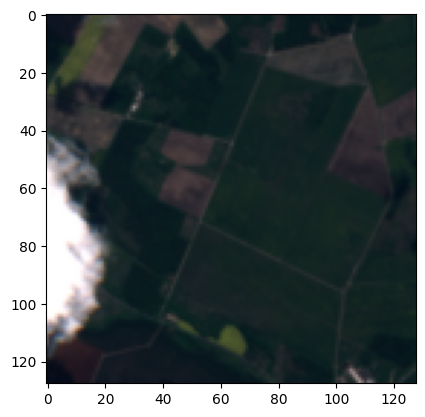

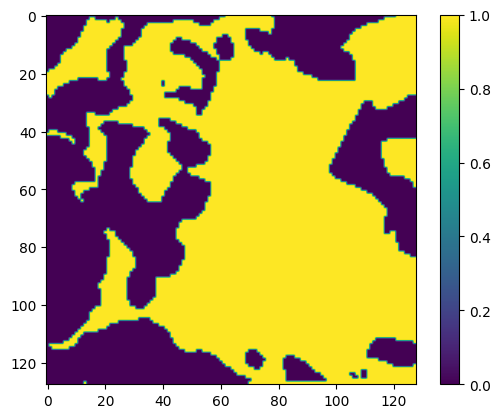

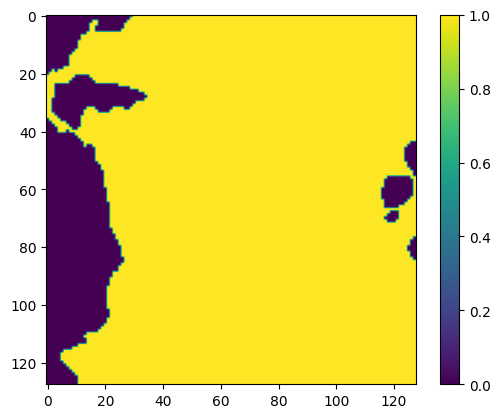

loss: tensor(1.2684, grad_fn=<DivBackward1>)


In [14]:

plt.figure()
plt.imshow(images_disp[0][:3].permute(1,2,0))
plt.show()
i=1

predictions_softmax = nn.Softmax(dim=1)(predictions.detach())
a = predictions_softmax.argmax (1)
predictions_binary = torch.zeros (predictions_softmax.shape).scatter (1, a.unsqueeze (1), 1.0)

plt.figure()
img=plt.imshow(predictions_binary[0][i:i+1].permute(1,2,0),vmin=0, vmax=1)
plt.colorbar(img)
plt.show()

plt.figure()
img=plt.imshow(from_one_hot(labels[0]).permute(1,2,0),vmin=0, vmax=5)
plt.colorbar(img)
plt.show()

print("loss:",criterion(predictions,labels.float()))

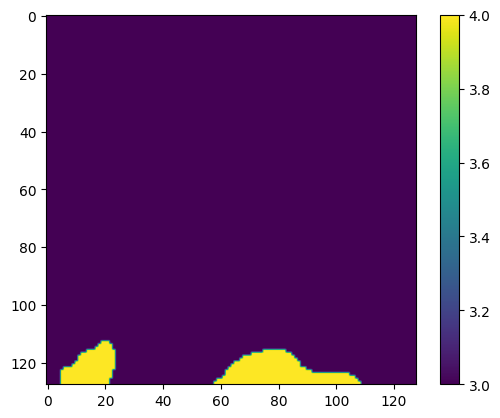

In [10]:


l = (from_one_hot(labels[0]))

plt.figure()
img=plt.imshow(l.permute(1,2,0))
plt.colorbar(img)
plt.show()

In [35]:
images,labels = next(test_it)
predictions = best_model(images)

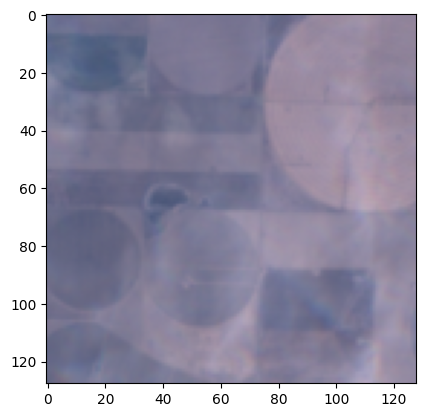

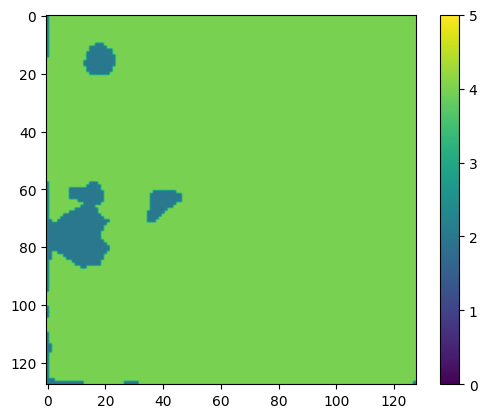

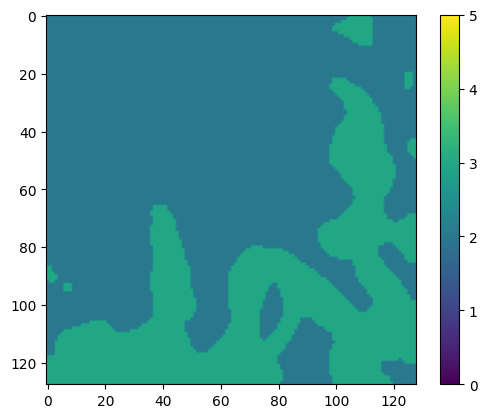

loss: tensor(1.3367, grad_fn=<DivBackward1>)


In [41]:
images,labels = next(test_it)
predictions = best_model(images)

plt.figure()
plt.imshow(images[0][:3].permute(1,2,0))
plt.show()

predictions_softmax = nn.Softmax(dim=1)(predictions.detach())
a = predictions_softmax.argmax (1)
predictions_binary = torch.zeros (predictions_softmax.shape).scatter (1, a.unsqueeze (1), 1.0)

plt.figure()
img=plt.imshow(from_one_hot(predictions_binary[0]).permute(1,2,0),vmin=0, vmax=5)
plt.colorbar(img)
plt.show()


plt.figure()
img=plt.imshow(from_one_hot(labels[0]).permute(1,2,0),vmin=0, vmax=5)
plt.colorbar(img)
plt.show()

print("loss:",criterion(predictions,labels.float()))

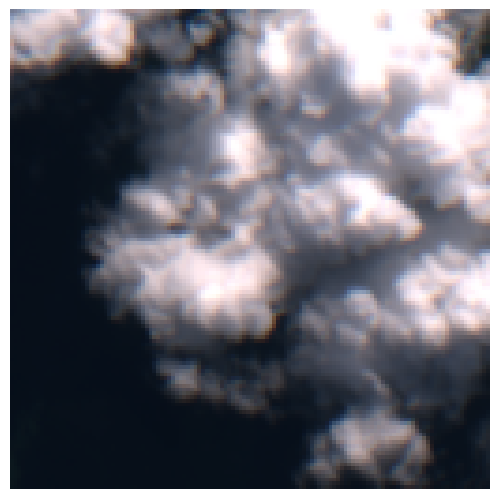

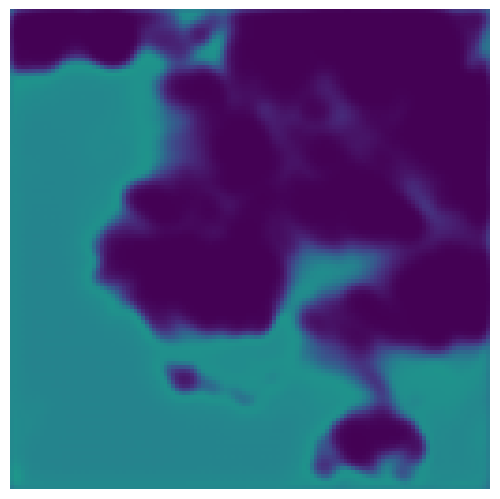

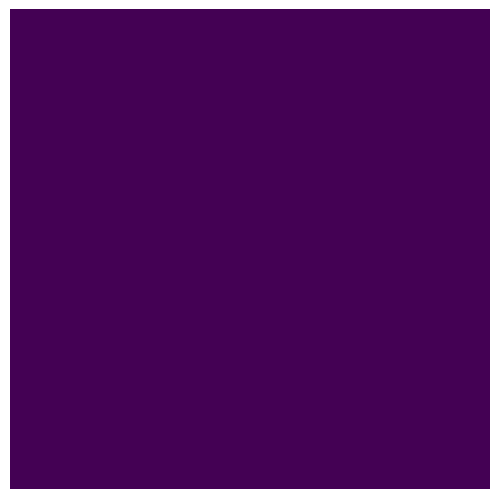

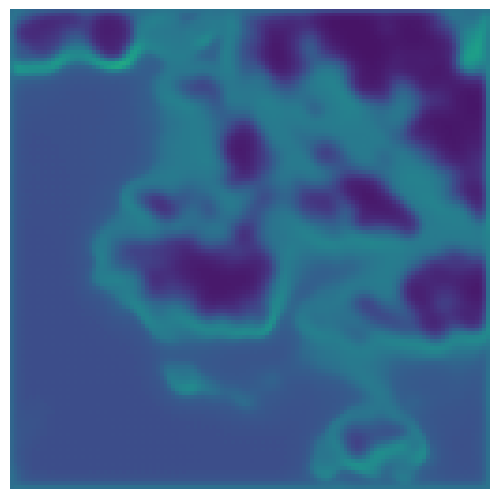

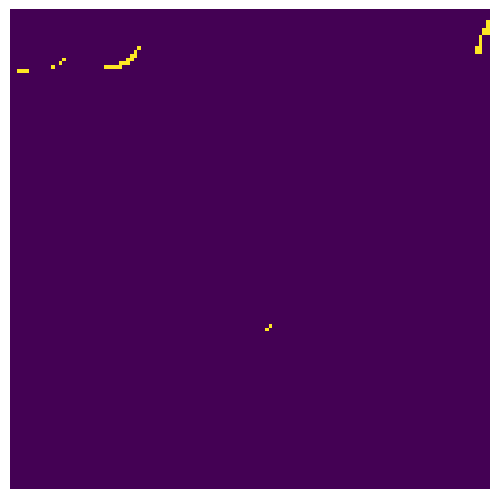

...

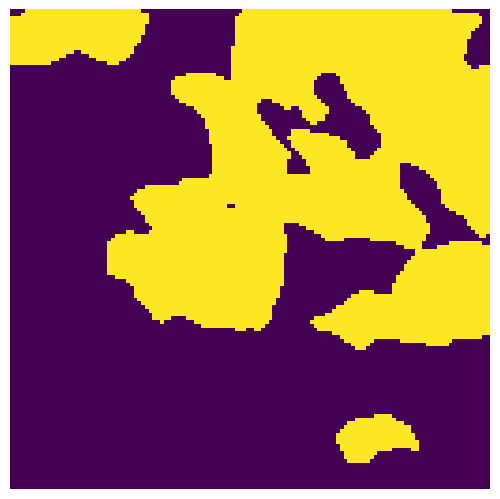

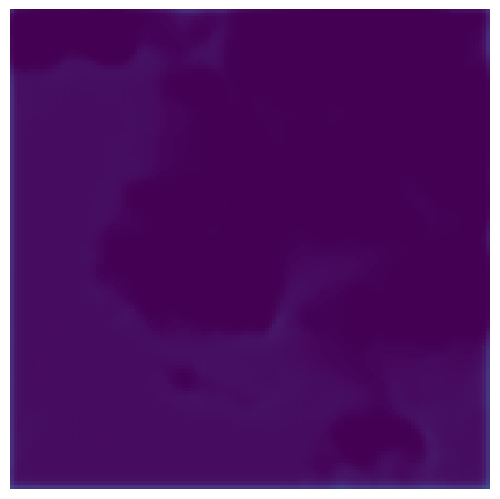

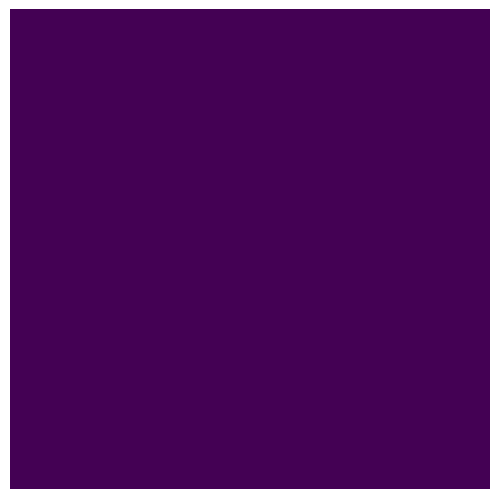

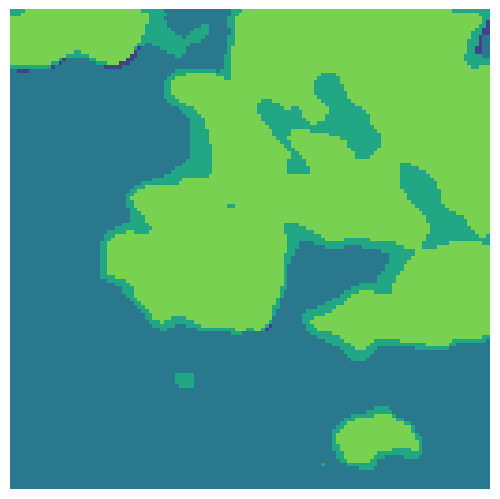

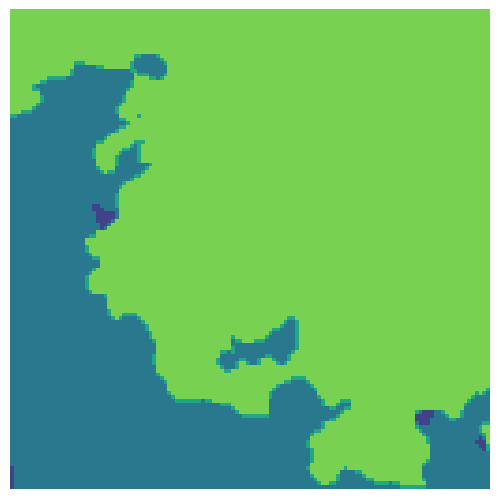

loss: tensor(1.0568, grad_fn=<DivBackward1>)


In [50]:
#For creating images

predictions = best_model(images)

predictions_softmax = nn.Softmax(dim=1)(predictions.detach())
a = predictions_softmax.argmax (1)
predictions_binary = torch.zeros (predictions_softmax.shape).scatter (1, a.unsqueeze (1), 1.0)

fig = plt.figure(frameon=False)
ax = plt.Axes(fig, [0., 0., 1., 1.])
ax.set_axis_off()
fig.add_axes(ax)
ax.imshow(images_disp[0][:3].permute(1,2,0))
plt.savefig('img.jpg', bbox_inches='tight',pad_inches=0)
plt.show()

for i in range(6):

    fig = plt.figure(frameon=False)
    ax = plt.Axes(fig, [0., 0., 1., 1.])
    ax.set_axis_off()
    fig.add_axes(ax)
    ax.imshow(predictions_softmax[0][i:i+1].permute(1,2,0),vmin=0, vmax=0.5)
    plt.savefig('softmax'+str(i)+'.jpg', bbox_inches='tight',pad_inches=0)
    plt.show()

    fig = plt.figure(frameon=False)
    ax = plt.Axes(fig, [0., 0., 1., 1.])
    ax.set_axis_off()
    fig.add_axes(ax)
    ax.imshow(predictions_binary[0][i:i+1].permute(1,2,0),vmin=0, vmax=1)
    plt.savefig('binary'+str(i)+'.jpg', bbox_inches='tight',pad_inches=0)
    plt.show()



fig = plt.figure(frameon=False)
ax = plt.Axes(fig, [0., 0., 1., 1.])
ax.set_axis_off()
fig.add_axes(ax)
ax.imshow(from_one_hot(predictions_binary[0]).permute(1,2,0),vmin=0, vmax=5)
plt.savefig('predictions.jpg', bbox_inches='tight',pad_inches=0)
plt.show()


fig = plt.figure(frameon=False)
ax = plt.Axes(fig, [0., 0., 1., 1.])
ax.set_axis_off()
fig.add_axes(ax)
ax.imshow(from_one_hot(labels[0]).permute(1,2,0),vmin=0, vmax=5)
plt.savefig('label.jpg', bbox_inches='tight',pad_inches=0)
plt.show()

print("loss:",criterion(predictions,labels.float()))


In [63]:
_,labels,_ = next(iter(training_loader))

In [81]:

vs = [0,0,0,0,0,0]
total=0
for batch_nr, (_,labels) in enumerate(training_loader):
    for label in labels:
        i=0
        while i<6:
            sum = torch.sum(label[i:i+1]).item()
            vs[i]+=sum
            total+=sum
            i+=1
for batch_nr, (_,labels) in enumerate(validation_loader):
    for label in labels:
        i=0
        while i<6:
            sum = torch.sum(label[i:i+1]).item()
            vs[i]+=sum
            total+=sum
            i+=1
print(vs)
m = max(vs)
for i, e in enumerate(vs):
    vs[i]=m/e
print(vs)

[830, 521225, 199987, 339080, 326761, 70293]
[627.9819277108434, 1.0, 2.606294409136594, 1.537174118202194, 1.5951261013401232, 7.415034213933109]


In [24]:
#Evaluate
total = 0
correct = 0

for batch_nr, (images, labels) in enumerate(test_loader):

    predictions = best_model(images)

    predictions_softmax = nn.Softmax(dim=1)(predictions.detach())
    predictions_binary = torch.zeros(predictions_softmax.shape).scatter (1, predictions_softmax.argmax(1).unsqueeze(1), 1.0)

    i=0
    while i<len(predictions):
        pred = from_one_hot(predictions_binary[i])
        label = from_one_hot(labels[i])

        y = torch.sum((pred==label))
        correct += y
        total += 128*128
        i+=1

print("Accuracy =", correct/total)

    

Accuracy = tensor(0.5591)


In [5]:
model = torch.load("best_UNET128c_model.pt")
it = iter(model.children())
child = next(it)

In [37]:

child = next(it)
print(type(child)==torch.nn.modules.conv.Conv2d)
print(child.weight.data.shape)
print(str(child))

True
torch.Size([256, 256, 3, 3])
Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))


In [6]:
import random
for child in model.children():
    if type(child)!=torch.nn.modules.conv.Conv2d:
        continue

    print(child.weight.data.shape)
    print(child.weight.data[0,0,:,:])
    #subplot(r,c) provide the no. of rows and columns
    disp1=(random.sample(range(0, child.weight.data.shape[0]), 64))
    disp2=(random.sample(range(0, child.weight.data.shape[1]), 12))
    rows=64
    cols = 12
    plt.rcParams['figure.figsize'] = [150, 90]
    f, axarr = plt.subplots(cols*2,rows//2) 
    for row in range(rows):
        for col in range(cols):
            if row<32:
                axarr[col*2][row%32].imshow(child.weight.data[disp1[row],disp2[col],:,:])
            else:
                axarr[col*2+1][row%32].imshow(child.weight.data[disp1[row],disp2[col],:,:])
    plt.show()



torch.Size([64, 12, 3, 3])
tensor([[-0.0863, -0.0413, -0.0614],
        [ 0.0718, -0.0020,  0.0237],
        [-0.0626, -0.0971, -0.0742]])


torch.Size([64, 64, 3, 3])
tensor([[ 0.0046, -0.0350,  0.0234],
        [ 0.0326, -0.0110,  0.0235],
        [-0.0040, -0.0146,  0.0179]])


torch.Size([128, 64, 3, 3])
tensor([[-0.0200, -0.0324, -0.0407],
        [ 0.0202,  0.0332, -0.0392],
        [-0.0230,  0.0188, -0.0230]])


torch.Size([128, 128, 3, 3])
tensor([[ 0.0132, -0.0163, -0.0061],
        [-0.0142,  0.0185, -0.0129],
        [ 0.0083, -0.0303,  0.0232]])


torch.Size([256, 128, 3, 3])
tensor([[ 0.0314, -0.0067,  0.0263],
        [ 0.0077,  0.0291, -0.0209],
        [ 0.0035, -0.0124, -0.0085]])


torch.Size([256, 256, 3, 3])
tensor([[ 6.8494e-03, -1.6848e-02,  1.0706e-02],
        [ 2.9921e-03, -1.8493e-02,  1.5052e-03],
        [-1.7406e-02, -9.3753e-05,  1.0192e-03]])


torch.Size([512, 256, 3, 3])
tensor([[-0.0106, -0.0095,  0.0176],
        [ 0.0055, -0.0045, -0.0156],
        [-0.0149, -0.0160, -0.0083]])


torch.Size([512, 512, 3, 3])
tensor([[ 0.0091,  0.0127, -0.0012],
        [-0.0031,  0.0010, -0.0120],
        [-0.0062, -0.0117,  0.0135]])


torch.Size([1024, 512, 3, 3])
tensor([[ 0.0061,  0.0003,  0.0007],
        [-0.0055, -0.0037, -0.0094],
        [ 0.0057, -0.0059,  0.0112]])


torch.Size([1024, 1024, 3, 3])
tensor([[ 0.0054,  0.0056, -0.0099],
        [ 0.0009, -0.0041,  0.0015],
        [-0.0117, -0.0016, -0.0001]])


torch.Size([2048, 1024, 3, 3])
tensor([[ 0.0013, -0.0028, -0.0087],
        [ 0.0016,  0.0028, -0.0050],
        [ 0.0049, -0.0038, -0.0028]])


torch.Size([2048, 2048, 3, 3])
tensor([[-0.0070, -0.0064, -0.0036],
        [ 0.0032, -0.0060, -0.0044],
        [-0.0058, -0.0051, -0.0018]])


torch.Size([1024, 2048, 3, 3])
tensor([[-0.0082,  0.0006, -0.0090],
        [ 0.0021,  0.0028,  0.0035],
        [-0.0017, -0.0089, -0.0083]])


torch.Size([1024, 1024, 3, 3])
tensor([[-0.0136,  0.0007, -0.0100],
        [ 0.0015, -0.0125,  0.0067],
        [-0.0017,  0.0060, -0.0070]])


torch.Size([512, 1024, 3, 3])
tensor([[-0.0076, -0.0070, -0.0051],
        [ 0.0029,  0.0047,  0.0042],
        [-0.0068,  0.0052, -0.0109]])


torch.Size([512, 512, 3, 3])
tensor([[ 0.0057,  0.0103,  0.0018],
        [-0.0152,  0.0060, -0.0041],
        [-0.0035, -0.0147, -0.0003]])


torch.Size([256, 512, 3, 3])
tensor([[-0.0018,  0.0026,  0.0170],
        [ 0.0024,  0.0198,  0.0200],
        [ 0.0054,  0.0151,  0.0167]])


torch.Size([256, 256, 3, 3])
tensor([[-0.0033, -0.0225, -0.0187],
        [ 0.0060, -0.0251, -0.0105],
        [-0.0197,  0.0001, -0.0134]])


torch.Size([128, 256, 3, 3])
tensor([[-0.0089, -0.0125,  0.0097],
        [ 0.0180, -0.0002, -0.0039],
        [-0.0076,  0.0109,  0.0128]])


torch.Size([128, 128, 3, 3])
tensor([[ 0.0077, -0.0184, -0.0241],
        [-0.0243, -0.0072, -0.0175],
        [-0.0109, -0.0125, -0.0264]])


torch.Size([64, 128, 3, 3])
tensor([[-0.0158, -0.0130, -0.0131],
        [-0.0238, -0.0333, -0.0234],
        [-0.0248, -0.0172, -0.0105]])


torch.Size([64, 64, 3, 3])
tensor([[-0.0207, -0.0031,  0.0443],
        [-0.0193,  0.0124,  0.0136],
        [ 0.0262,  0.0097, -0.0351]])


torch.Size([6, 64, 1, 1])
tensor([[-0.0493]])


ValueError: Sample larger than population or is negative

In [26]:
# IoU calculation

Union = [0,0,0,0,0,0] 
Intersection = [0,0,0,0,0,0]

for batch_nr, (images, labels) in enumerate(test_loader):

    predictions = best_model(images)

    predictions_softmax = nn.Softmax(dim=1)(predictions.detach())
    predictions_binary = torch.zeros(predictions_softmax.shape).scatter (1, predictions_softmax.argmax(1).unsqueeze(1), 1.0)

    i=0
    while i<len(predictions):
        pred = from_one_hot(predictions_binary[i])
        label = from_one_hot(labels[i])

        for p_class in range(6):
            inter=torch.sum((pred==label)*(label==p_class))
            uni = (torch.sum((label==p_class)) + torch.sum((label==p_class)) - inter)
            Intersection[p_class] += inter.item()
            Union[p_class] += uni.item()
        i+=1

for p_class in range(6):
    try:
        print("IoU, class=",p_class,":",Intersection[p_class]/Union[p_class])
    except:
        print("IoU, class=",p_class,":","NAN (Union=0)")

IoU, class= 0 : 0.0
IoU, class= 1 : 0.3872172357611212
IoU, class= 2 : 0.4836003103479055
IoU, class= 3 : 0.12131235586457666
IoU, class= 4 : 0.6140977847539498
IoU, class= 5 : 0.9586737289403597
